# Implementation of a DCGAN 
as described in [Redford et al.](https://arxiv.org/pdf/1511.06434.pdf) and [Goodfellow et al.](https://papers.baulab.info/papers/Goodfellow-2014.pdf)

following [PyTorch tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)

In [6]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

In [7]:
dataroot = "~/data/celeba"    # Root directory for dataset
workers = 2                 # Number of workers for dataloader
batch_size = 128            # Batch size during training
image_size = 64             # Spatial size of training images (All images will be resized to this size using a transformer)
nc = 3                      # Number of channels in the training images. For color images this is 3
nz = 100                    # Size of z latent vector (i.e. size of generator input)
ngf = 64                    # Size of feature maps in generator
ndf = 64                    # Size of feature maps in discriminator
num_epochs = 5              # Number of training epochs
lr = 0.0002                 # Learning rate for optimizers
beta1 = 0.5                 # Beta1 hyperparameter for Adam optimizers
ngpu = 1                    # Number of GPUs available. Use 0 for CPU mode.

## Data

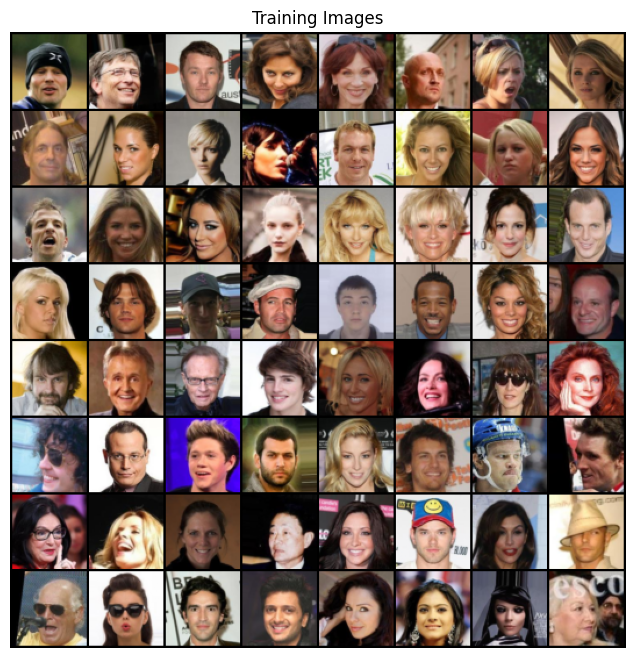

In [8]:
# Data
dataset = dset.ImageFolder(root=dataroot, transform=transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
]))

dataloader = torch.utils.data.DataLoader(
    dataset, 
    batch_size=batch_size,
    shuffle=True, 
    num_workers=workers
)

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# Models

In [12]:
# Weight initialization - call on model to initialize weights with N(0, 0.02)
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator

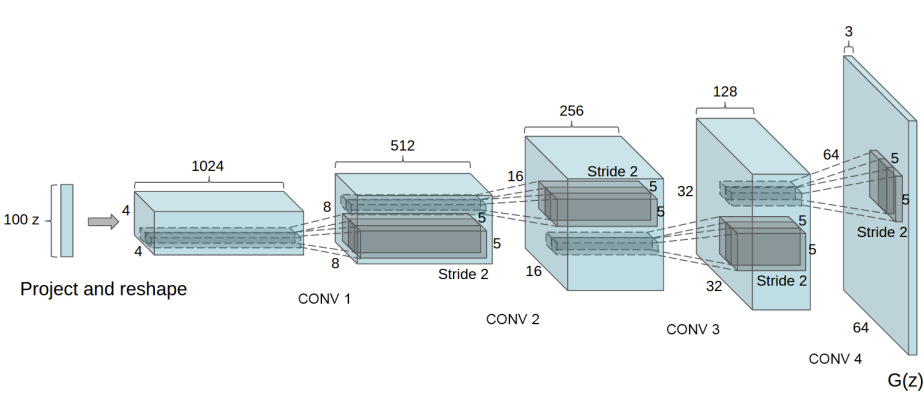

In [13]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input Z is (nz) x 1 x 1, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [14]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Discriminator

In [5]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
            # state size. 1 x 1 x 1
        )

    def forward(self, input):
        return self.main(input)

NameError: name 'nn' is not defined

In [4]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

NameError: name 'Discriminator' is not defined

## Loss Function and Optimizers

In [17]:
criterion = nn.BCELoss() # Initialize the BCELoss function

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# Train

In [18]:
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################        
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_batch = data[0].to(device)
        b_size = real_batch.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device) # y=1
        
        output = netD(real_batch).view(-1)      # Forward pass real batch through D
        errD_real = criterion(output, label)    # Calculate loss on all-real batch - y is all 1s, so log(D(x)) is maximized
        errD_real.backward()                    # Calculate gradients for D in backward pass
        D_x = output.mean().item()              # Save predictions of D on the all-real batch - D(x)

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device) # nz x 1 x 1
        # Generate fake image batch with G (y=0)
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)    # Calculate D's loss on the all-fake batch - # y is all 0s, so log(1 - D(G(z))) is maximized
        errD_fake.backward()                    # Calculate gradients for D in backward pass - accumulate gradients with real batch
        D_G_z1 = output.mean().item()           # Save predictions of D on the all-fake batch before updating D - D(G(z))

        errD = errD_real + errD_fake            # Compute error of D as sum over the fake and the real batches
        optimizerD.step()                       # Update D

        ############################
        # (2) Update G network: maximize log(D(G(z))) to minimize log(1 - D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost so that BCELoss maximizes log(D(G(z)))
        output = netD(fake).view(-1)            # Since we just updated D, perform another forward pass of all-fake batch through D
        errG = criterion(output, label)         # Calculate G's loss based on this output
        errG.backward()                         # Calculate gradients for G
        D_G_z2 = output.mean().item()           # Save predictions of D on the all-fake batch after updating D - D(G(z))

        optimizerG.step()                       # Update G

        # Output training stats
        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}]\tLoss_D: {errD.item():.4f}\tLoss_G: {errG.item():.4f}\tD(x): {D_x:.4f}\tD(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}')
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        iters += 1




[0/5][0/1583]	Loss_D: 1.6396	Loss_G: 6.7267	D(x): 0.7298	D(G(z)): 0.6601 / 0.0021
[0/5][50/1583]	Loss_D: 0.1300	Loss_G: 9.7342	D(x): 0.9392	D(G(z)): 0.0004 / 0.0006
[0/5][100/1583]	Loss_D: 0.2099	Loss_G: 7.3775	D(x): 0.8934	D(G(z)): 0.0036 / 0.0084
[0/5][150/1583]	Loss_D: 2.9712	Loss_G: 12.2546	D(x): 0.9660	D(G(z)): 0.8692 / 0.0000
[0/5][200/1583]	Loss_D: 0.8651	Loss_G: 8.2643	D(x): 0.9178	D(G(z)): 0.4668 / 0.0024
[0/5][250/1583]	Loss_D: 0.7387	Loss_G: 5.1381	D(x): 0.6495	D(G(z)): 0.0370 / 0.0147
[0/5][300/1583]	Loss_D: 0.7630	Loss_G: 2.7597	D(x): 0.7411	D(G(z)): 0.2797 / 0.0927
[0/5][350/1583]	Loss_D: 0.4439	Loss_G: 3.8389	D(x): 0.8834	D(G(z)): 0.2349 / 0.0334
[0/5][400/1583]	Loss_D: 0.8467	Loss_G: 2.2894	D(x): 0.6456	D(G(z)): 0.2326 / 0.1320
[0/5][450/1583]	Loss_D: 0.6977	Loss_G: 3.5644	D(x): 0.8005	D(G(z)): 0.3118 / 0.0509
[0/5][500/1583]	Loss_D: 0.5368	Loss_G: 5.5666	D(x): 0.9001	D(G(z)): 0.2804 / 0.0115
[0/5][550/1583]	Loss_D: 0.7103	Loss_G: 2.9508	D(x): 0.6117	D(G(z)): 0.0381 / 0

# Results

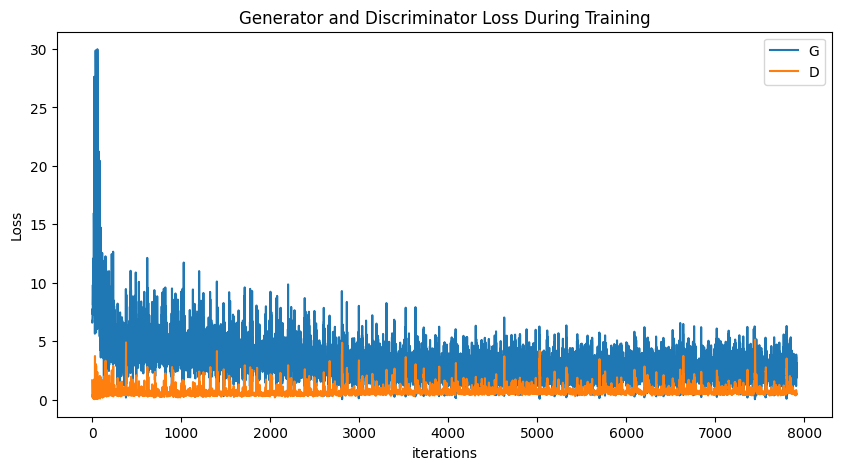

In [19]:
# Losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

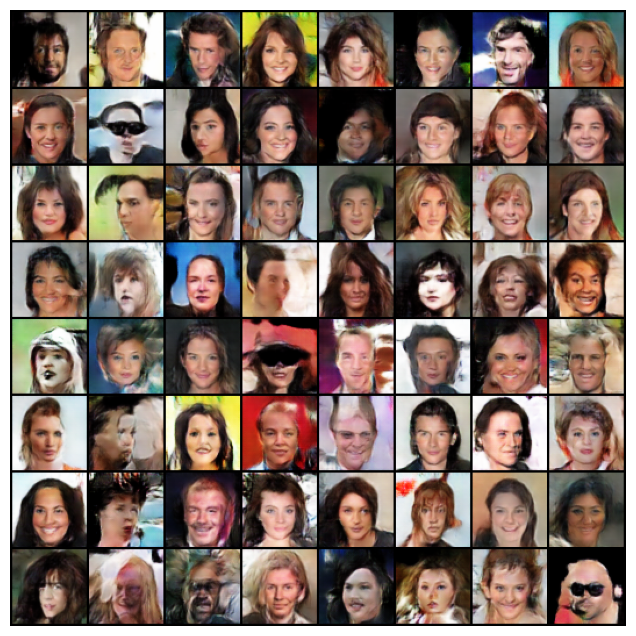

In [20]:
# Visualize G's progression
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

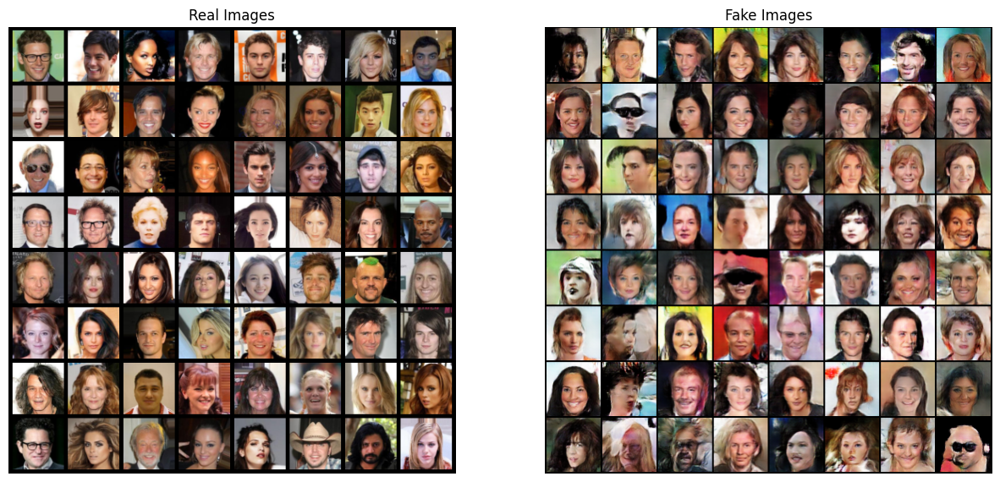

In [21]:
# Real Images vs. Fake Images
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()